<a href="https://colab.research.google.com/github/THUVAARAGAN/fyp/blob/main/pre_trained_model_road_side.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [15]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [16]:
!pip install transformers

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [3]:
from transformers import GPT2TokenizerFast, ViTImageProcessor, VisionEncoderDecoderModel

In [12]:
model_raw = VisionEncoderDecoderModel.from_pretrained("nlpconnect/vit-gpt2-image-captioning")

In [13]:
model_raw

VisionEncoderDecoderModel(
  (encoder): ViTModel(
    (embeddings): ViTEmbeddings(
      (patch_embeddings): ViTPatchEmbeddings(
        (projection): Conv2d(3, 768, kernel_size=(16, 16), stride=(16, 16))
      )
      (dropout): Dropout(p=0.0, inplace=False)
    )
    (encoder): ViTEncoder(
      (layer): ModuleList(
        (0-11): 12 x ViTLayer(
          (attention): ViTAttention(
            (attention): ViTSelfAttention(
              (query): Linear(in_features=768, out_features=768, bias=True)
              (key): Linear(in_features=768, out_features=768, bias=True)
              (value): Linear(in_features=768, out_features=768, bias=True)
              (dropout): Dropout(p=0.0, inplace=False)
            )
            (output): ViTSelfOutput(
              (dense): Linear(in_features=768, out_features=768, bias=True)
              (dropout): Dropout(p=0.0, inplace=False)
            )
          )
          (intermediate): ViTIntermediate(
            (dense): Linear(in_featur

In [4]:
image_processor = ViTImageProcessor.from_pretrained("nlpconnect/vit-gpt2-image-captioning")

In [5]:
image_processor

ViTImageProcessor {
  "do_normalize": true,
  "do_rescale": true,
  "do_resize": true,
  "feature_extractor_type": "ViTFeatureExtractor",
  "image_mean": [
    0.5,
    0.5,
    0.5
  ],
  "image_processor_type": "ViTImageProcessor",
  "image_std": [
    0.5,
    0.5,
    0.5
  ],
  "resample": 2,
  "rescale_factor": 0.00392156862745098,
  "size": {
    "height": 224,
    "width": 224
  }
}

In [7]:
tokenizer = GPT2TokenizerFast.from_pretrained("nlpconnect/vit-gpt2-image-captioning")

In [9]:
tokenizer

GPT2TokenizerFast(name_or_path='nlpconnect/vit-gpt2-image-captioning', vocab_size=50257, model_max_length=1024, is_fast=True, padding_side='right', truncation_side='right', special_tokens={'bos_token': '<|endoftext|>', 'eos_token': '<|endoftext|>', 'unk_token': '<|endoftext|>', 'pad_token': '<|endoftext|>'}, clean_up_tokenization_spaces=True)

In [8]:
# model_raw = VisionEncoderDecoderModel.from_pretrained("nlpconnect/vit-gpt2-image-captioning")
# image_processor = ViTImageProcessor.from_pretrained("nlpconnect/vit-gpt2-image-captioning")
# tokenizer       = GPT2TokenizerFast.from_pretrained("nlpconnect/vit-gpt2-image-captioning")

In [10]:
import matplotlib.pyplot as plt
from PIL import Image
import numpy as np

In [17]:
def show_n_generate(url, greedy = True, model = model_raw):
    # image = Image.open(requests.get(url, stream =True).raw)
    image = Image.open(url)
    pixel_values   = image_processor(image, return_tensors ="pt").pixel_values
    # print(pixel_values)
    # print(pixel_values.shape)
    plt.imshow(np.asarray(image))
    plt.show()

    if greedy:
        generated_ids  = model.generate(pixel_values, max_new_tokens = 30)
        # print("generated_ids (True)=", generated_ids)
    else:
        generated_ids  = model.generate(
            pixel_values,
            do_sample=True,
            max_new_tokens = 30,
            top_k=5)
        # print("generated_ids (else) =", generated_ids)
    generated_text = tokenizer.batch_decode(generated_ids, skip_special_tokens=True)[0]
    print("caption = ",generated_text)

In [18]:
# url1 = '/content/football.jpg'
# show_n_generate(url1, greedy = False)

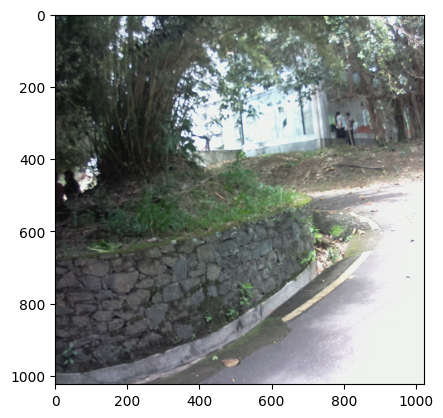

caption =  a small stone wall near trees and shrubs 


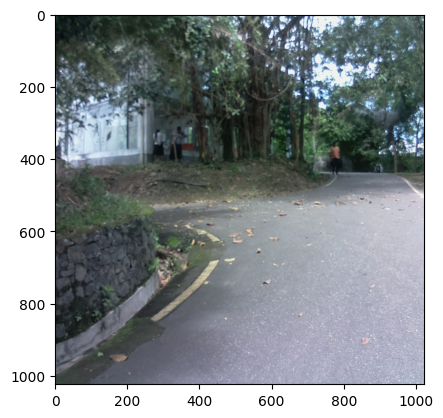

caption =  a sidewalk is shown with trees in the distance 


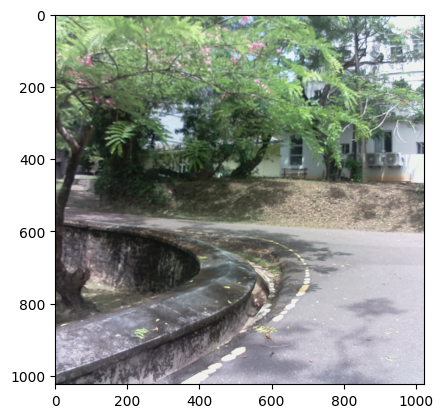

caption =  a tree sitting in the middle of the street 


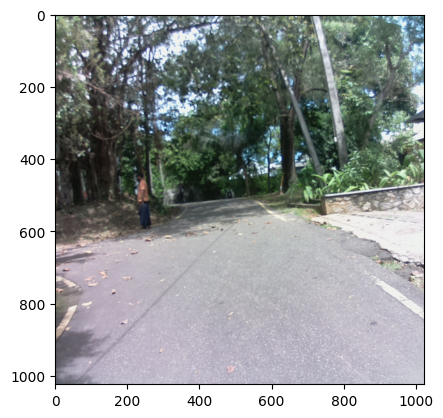

caption =  a man walking in the road by the woods 


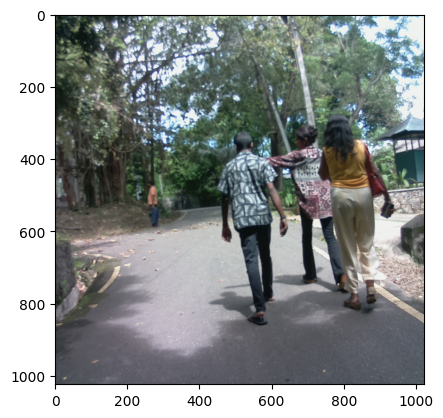

caption =  three people walking on the sidewalk in the middle of a city 


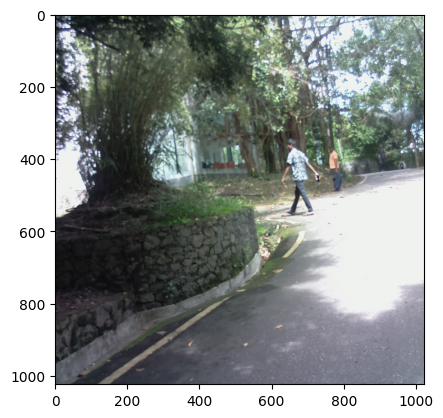

caption =  a man walking down a street with an umbrella 


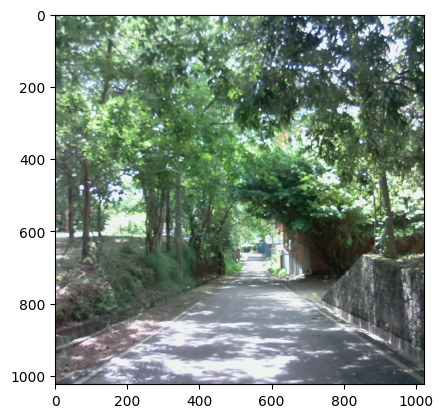

caption =  a street that leads to a stone wall and a path 


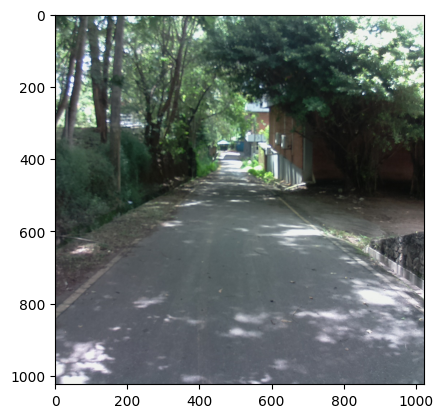

caption =  a narrow sidewalk that is lined up with a fence 


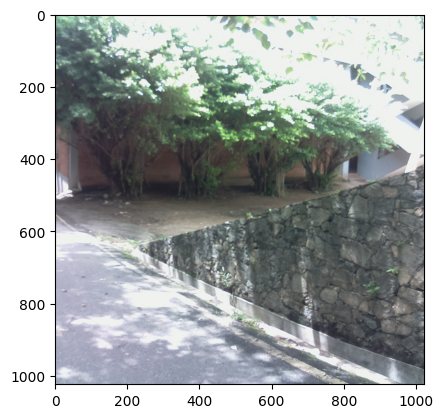

caption =  a tree is on a ledge in a building 


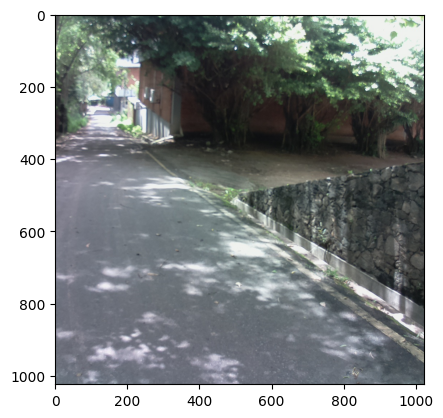

caption =  a stone wall is lined with stones near some trees 


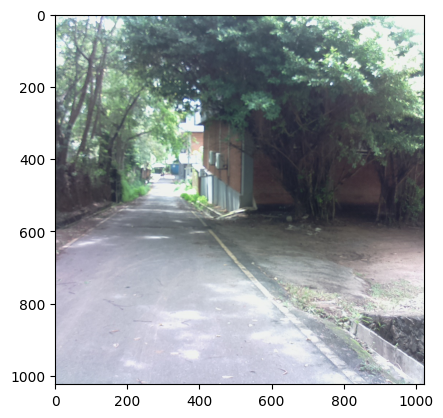

caption =  parked area with trees, bushes and a street light 


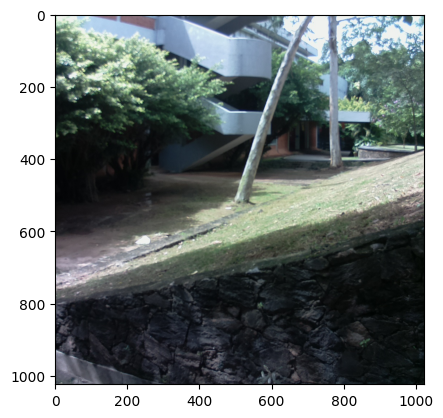

caption =  a tree is standing by a bridge 


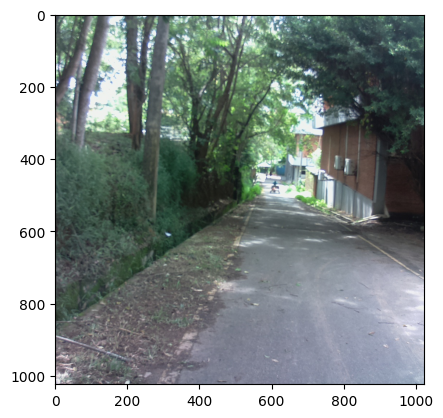

caption =  two trees and a street in a residential area 


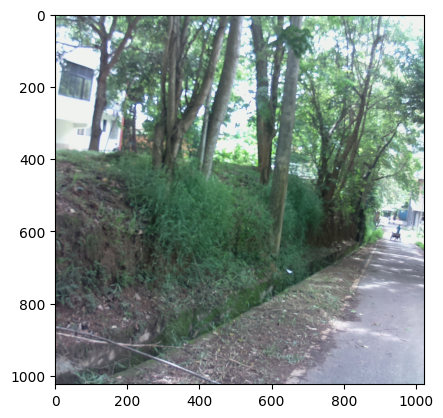

caption =  a path that is on the side of a road 


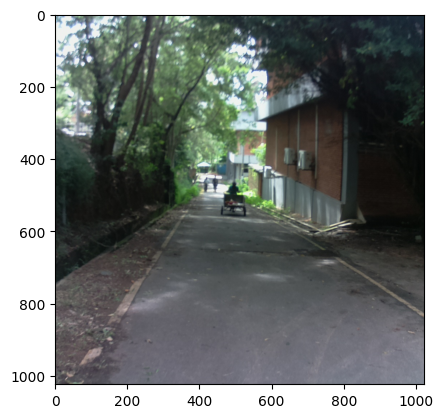

caption =  an old fashioned motorcycle parked in front of a building 


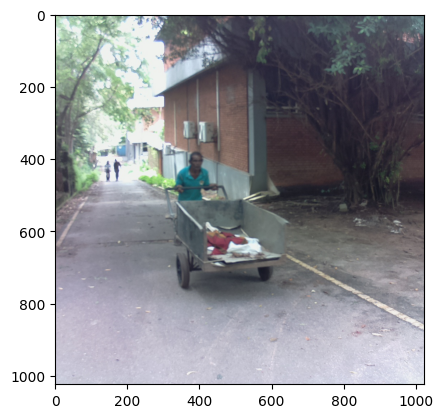

caption =  a truck that is parked in the street 


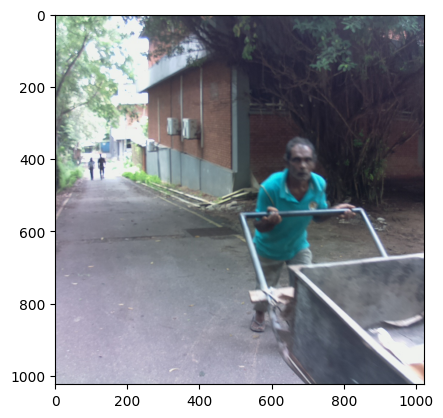

caption =  a man is standing in front of a boat on the sidewalk 


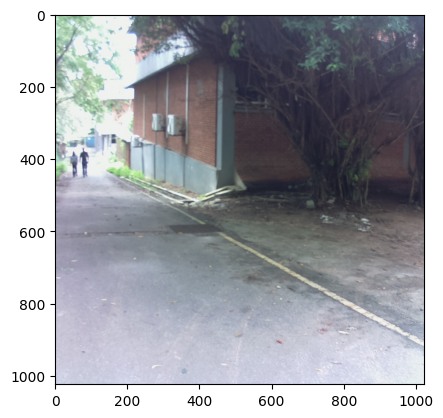

caption =  a white car parked in a residential area 


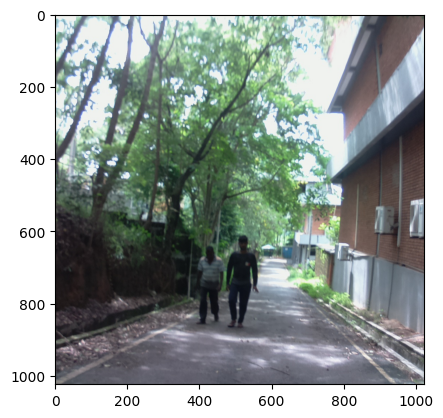

caption =  a pair of men walking down a street with a bicycle 


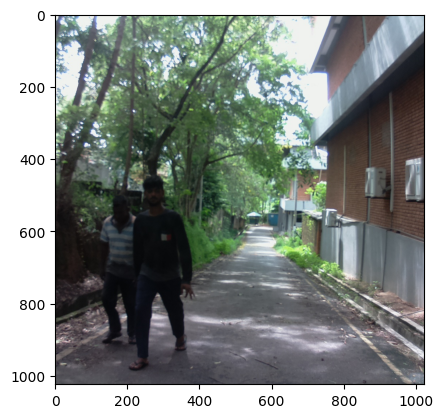

caption =  a man and woman walk down a sidewalk near a tree 


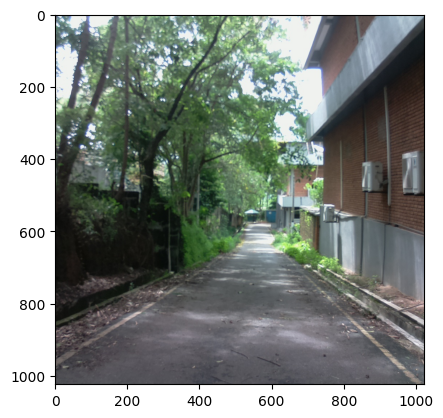

caption =  a narrow road is surrounded by tall buildings 


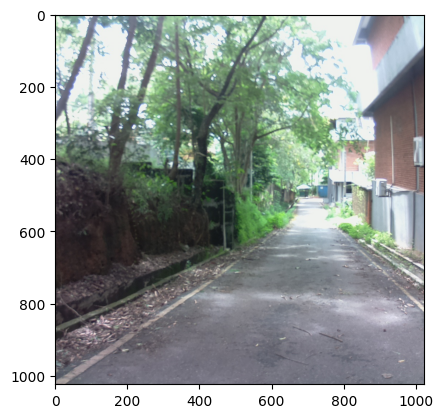

caption =  this is the only way for me to get outside of this area 


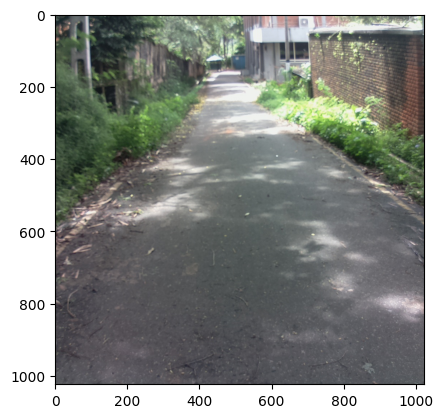

caption =  a sidewalk that has a lot of grass around it 


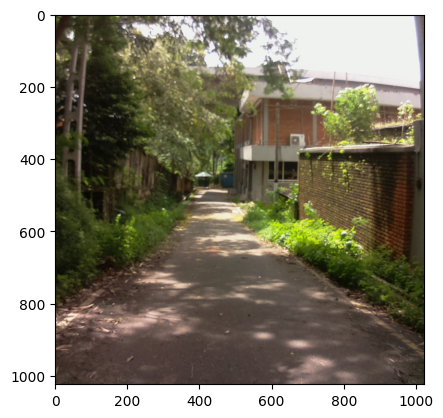

caption =  a street with a wooden path leading to a building 


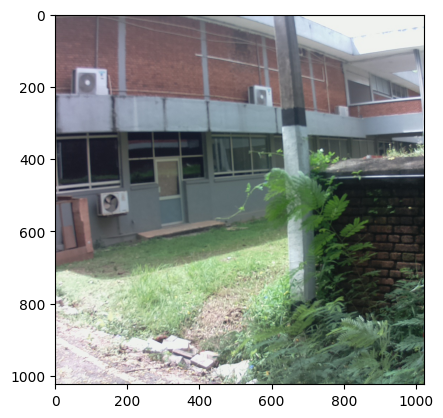

caption =  a brick wall with trees and bushes and a fence 


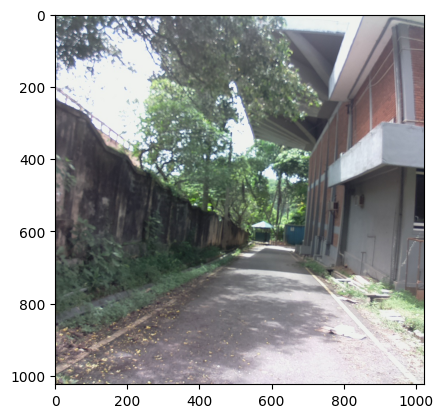

caption =  a street with a building next to a fence 


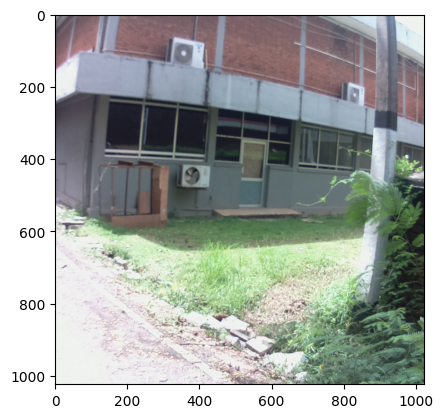

caption =  a large building that has been remodeled 


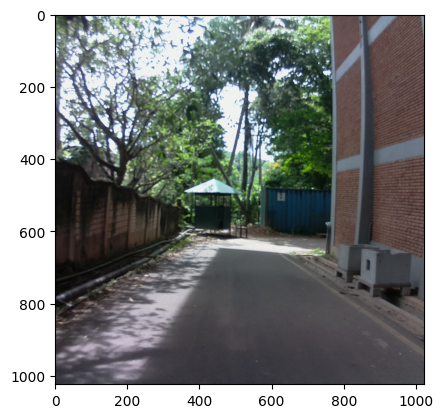

caption =  a street with a brick building with no trees 


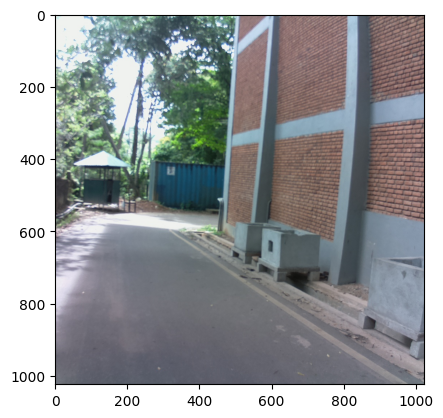

caption =  a street sign is hanging on a brick wall 


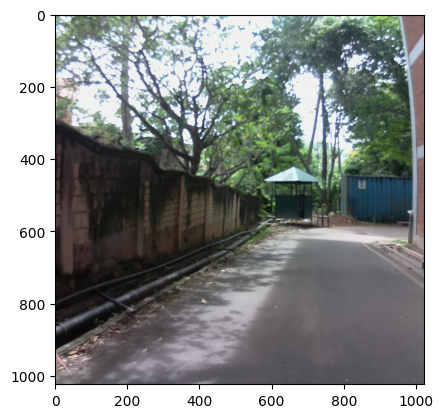

caption =  a walkway with a brick fence and trees 


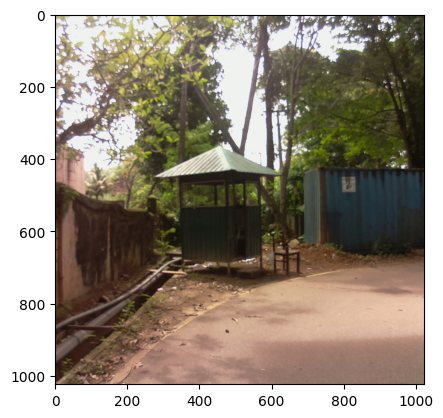

caption =  a wooden bench next to a fence in a rural area 


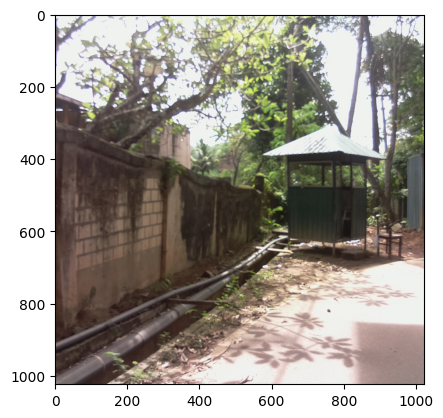

caption =  a small wooden walkway leading to a park 


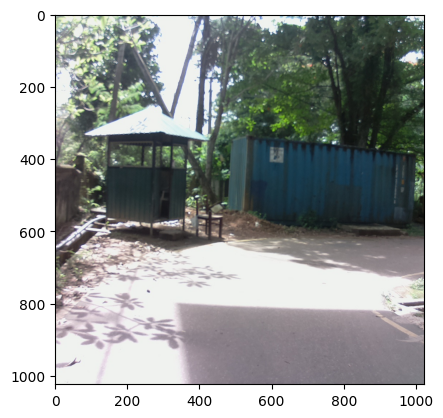

caption =  a wooden bench next to a road with trees 


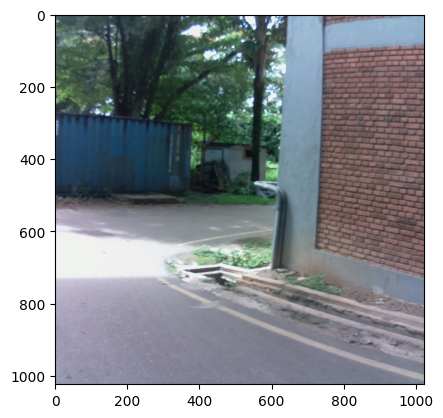

caption =  a busted up toilet is in an alley 


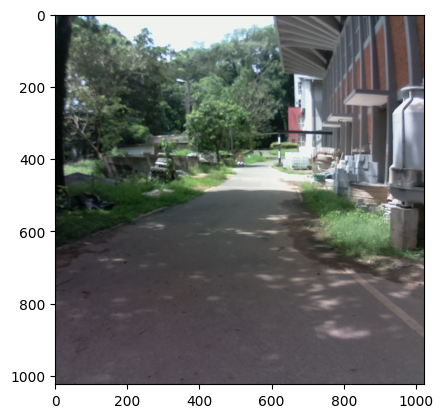

caption =  a house is being renovated in the middle of the road 


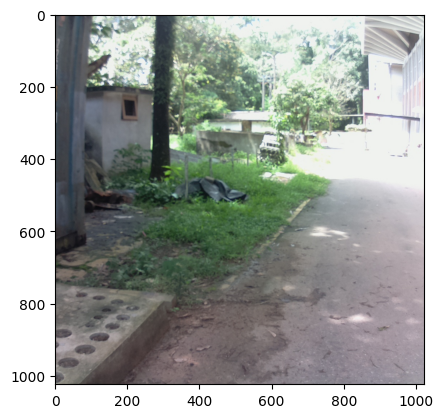

caption =  a cat is laying in the grass near a building 


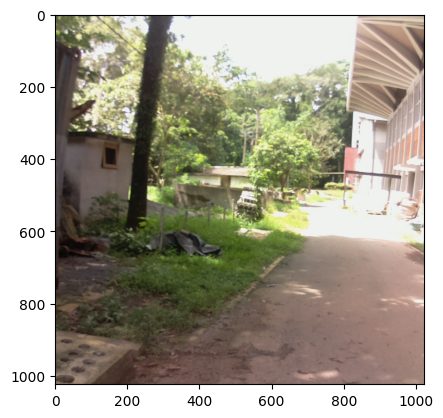

caption =  a cat sitting by a tree in the city 


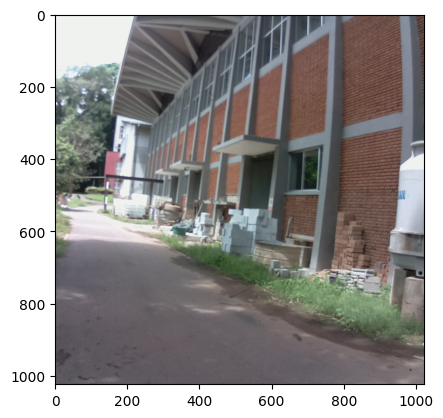

caption =  an old building is shown in a corner 


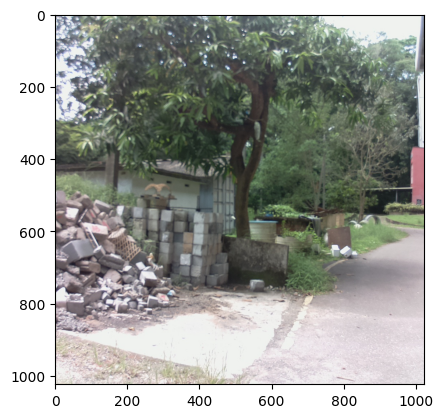

caption =  a pile of trees next to a street with a sign 


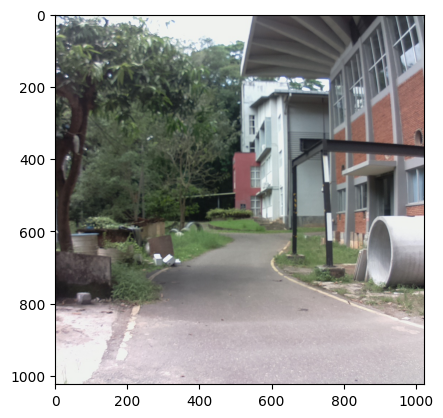

caption =  a fire hydrant in a street with trees 


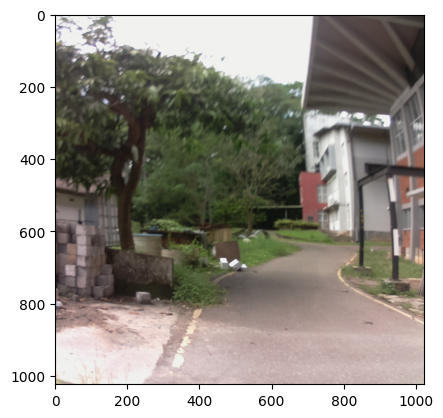

caption =  a street scene of a building surrounded by trees 


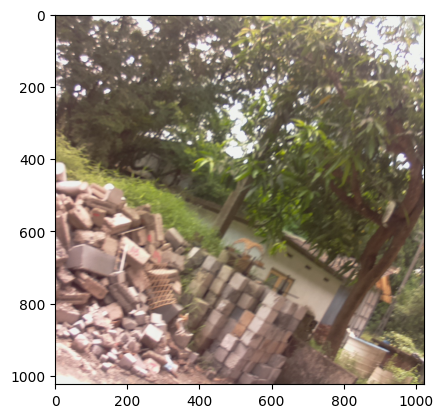

caption =  a wooden fence is surrounded by rocks and trees 


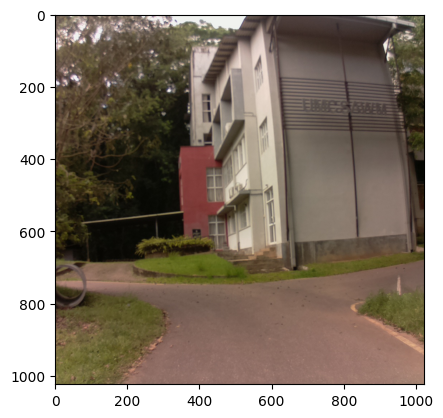

caption =  a small building that has a sign on it 


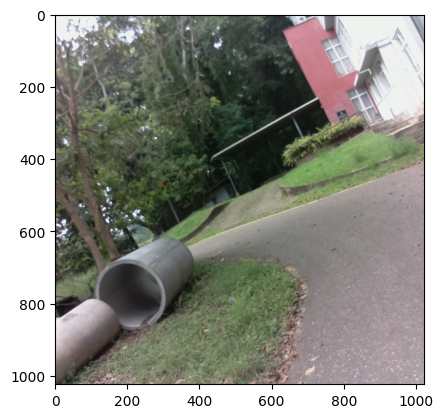

caption =  a fire hydrant sitting in the corner of a yard 


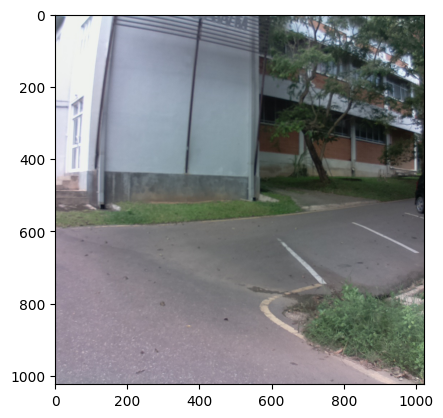

caption =  an old building that has been demolished and the grass has been covered up 


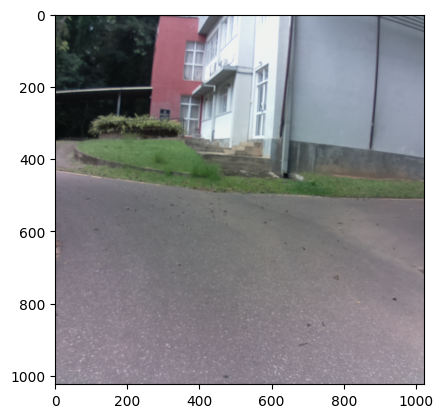

caption =  a house on a street next to a house 


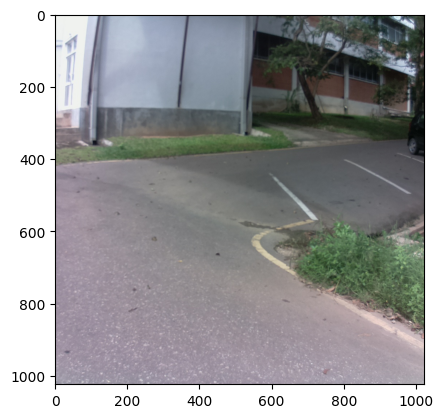

caption =  a broken down road with a broken down street 


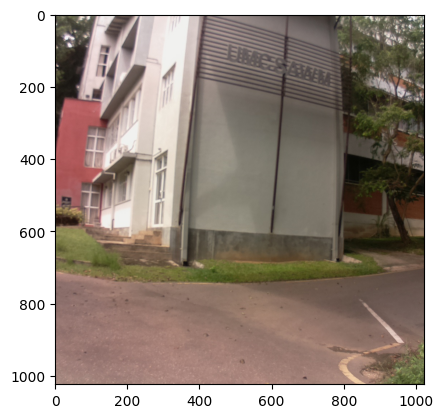

caption =  an open door to a building 


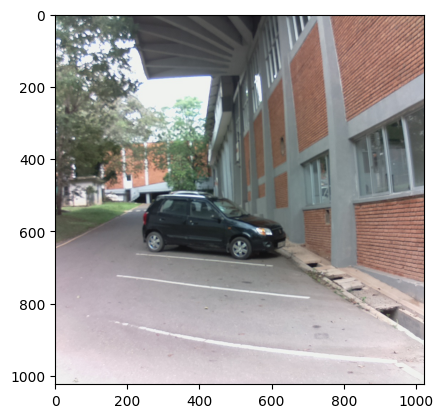

caption =  a car parked next to a brick building and the street is empty 


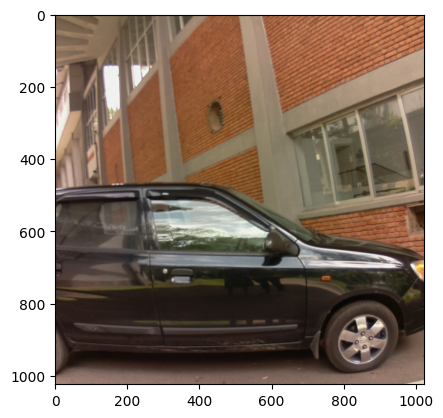

caption =  the front of an old black and white pick up truck 


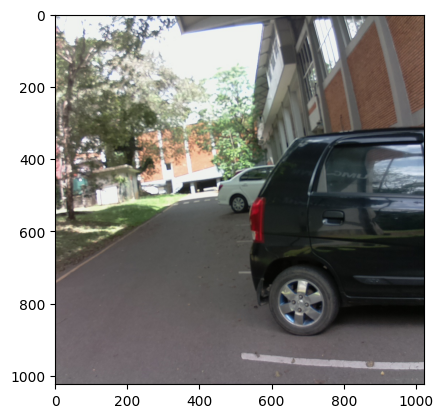

caption =  a car parked on a street near a building 


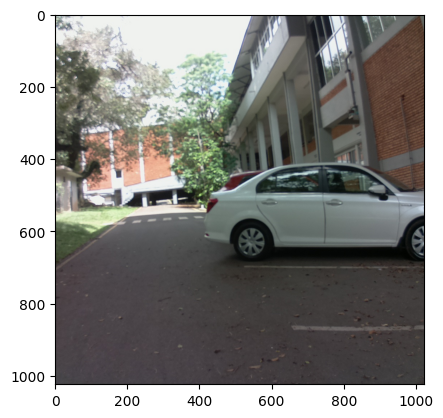

caption =  a white car parked on the side of a street 


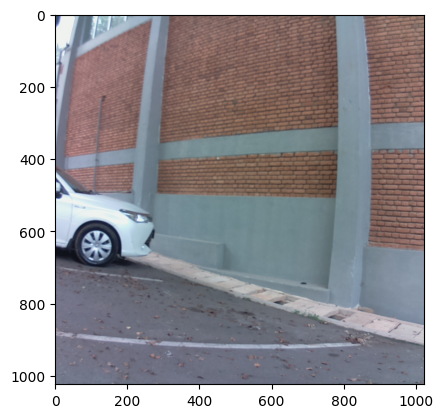

caption =  a white car with a white hood and a black door 


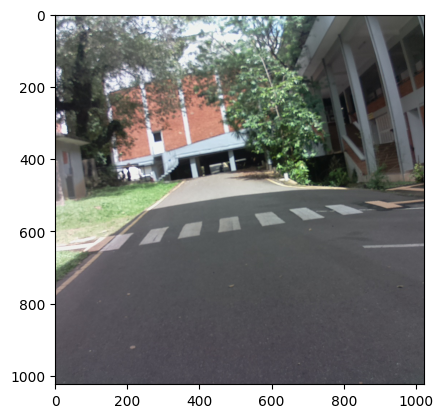

caption =  a white and black street sign in the grass 


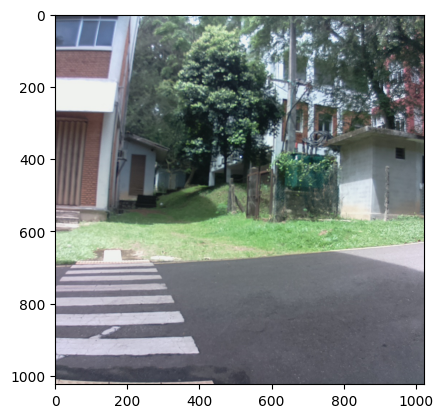

caption =  a house on an outside street 


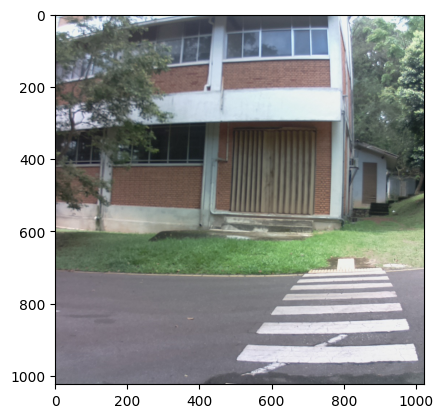

caption =  a building with windows is on the corner of a street 


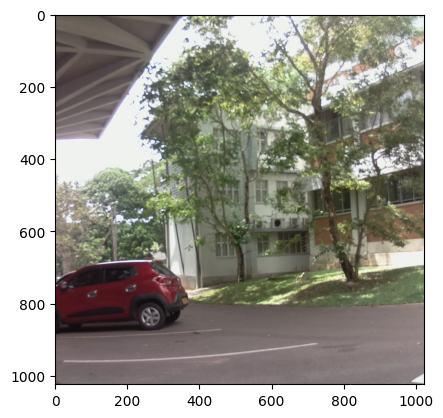

caption =  a red car parked on top of a curb next to a tree 


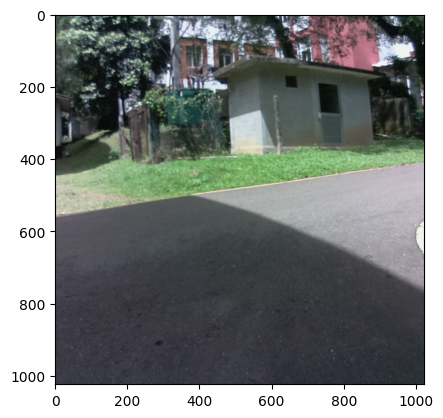

caption =  an empty house in the middle of the street with a house 


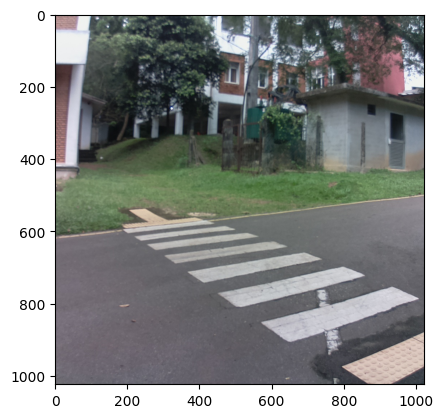

caption =  an intersection with two cars driving down a street 


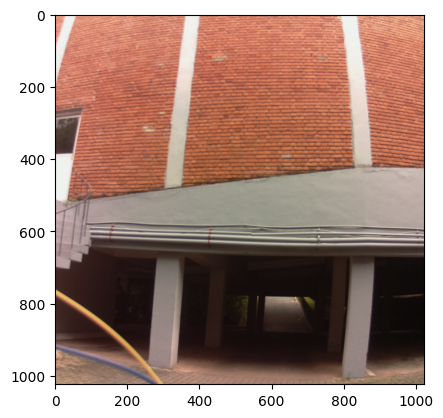

caption =  old buildings are shown in front of a brick wall 


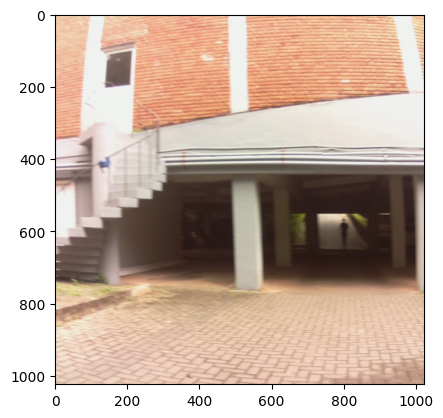

caption =  a building with stairs going up to the top 


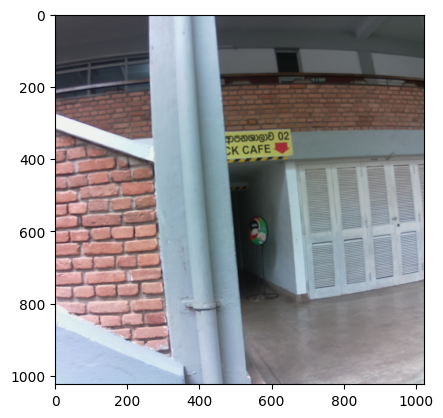

caption =  a green light that says "no left turn" on a brick wall 


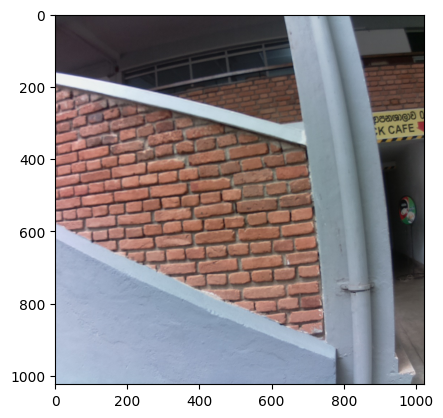

caption =  a building with a brick facade with a clock on it 


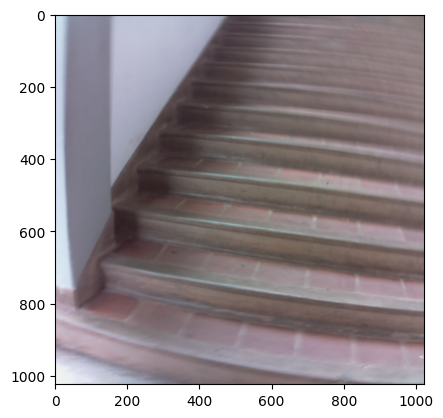

caption =  a set of stairs on a cement wall 


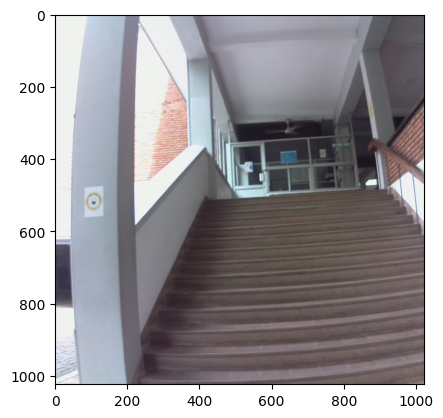

caption =  an old staircase with stairs on the other side 


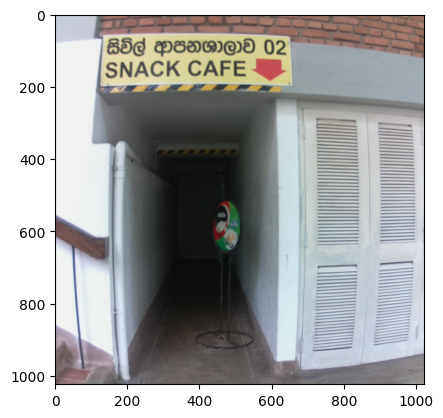

caption =  man standing by a sign outside a building 


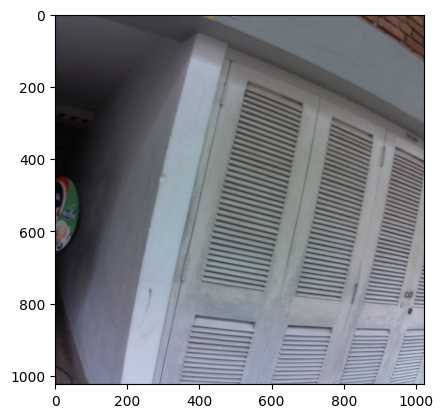

caption =  a window with a large open window and a black wall 


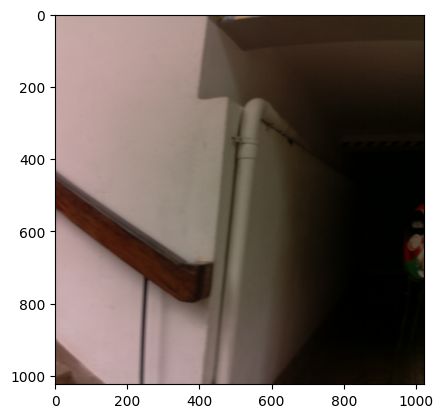

caption =  a white door with a white door 


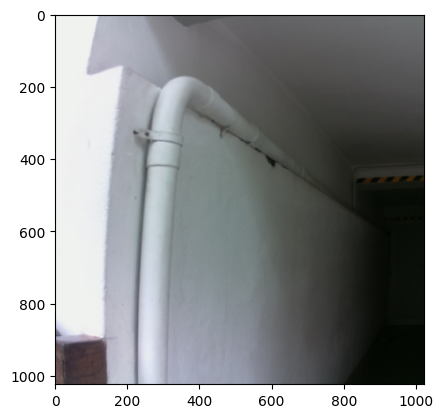

caption =  a wall that is covered with a white curtain 


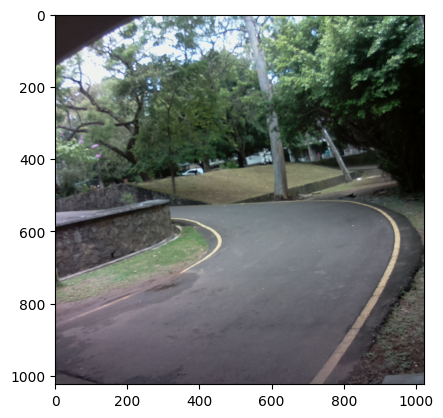

caption =  a street sign on a pole near a tree 


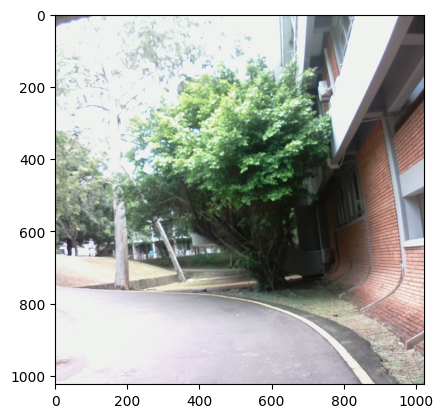

caption =  the trees are all in front of the building 


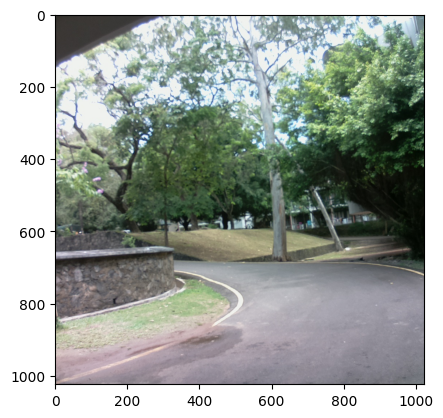

caption =  a tree lined street in the middle of a park 


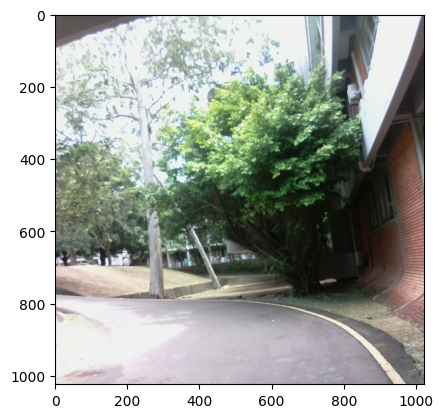

caption =  a tree is on the sidewalk next to a building 


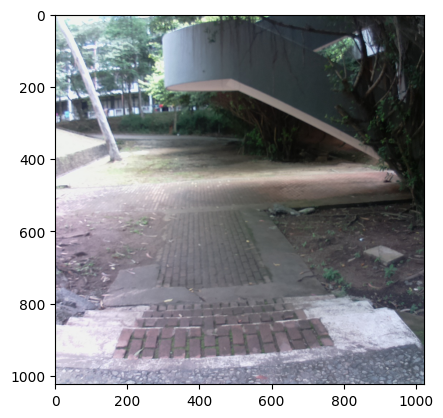

caption =  a large cement walkway with a brick wall 


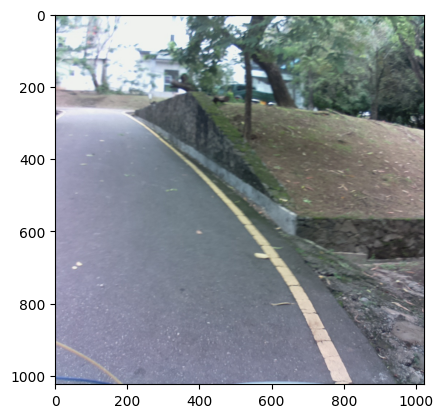

caption =  a sidewalk that is in the middle of a road 


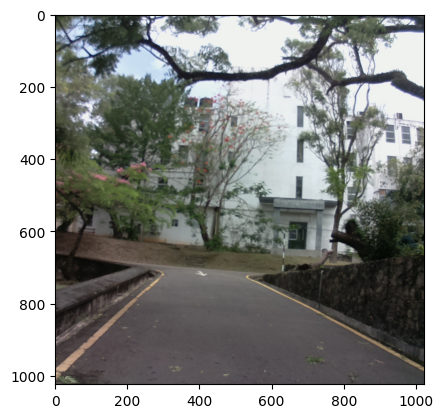

caption =  a house with a bird sitting in front of it 


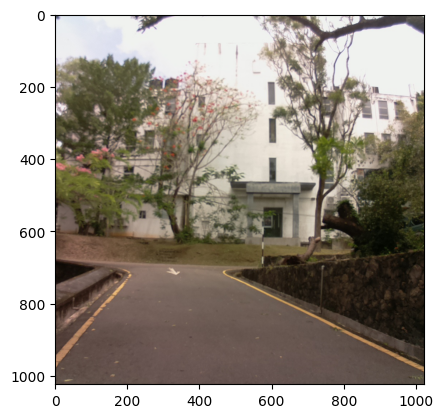

caption =  a large white building with a tree on the top 


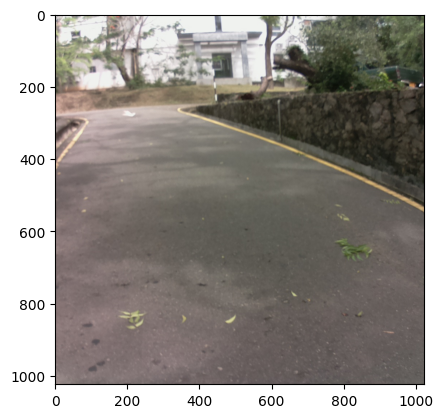

caption =  a street with a bunch of stones and a tree 


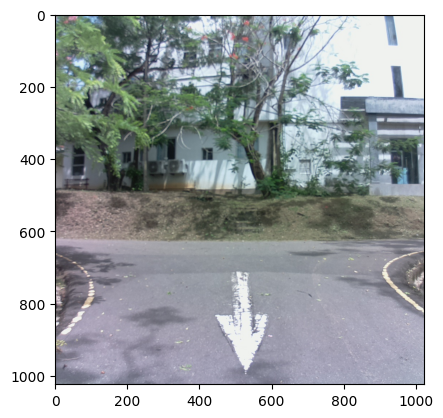

caption =  a street sign that is on the corner of a road 


In [21]:
for i in range(1,80):
  path1 = "/content/drive/MyDrive/Fyp/fine tune sample/uom-road dataset/caption writing /Image (" + str(i) + ").jpg"
  show_n_generate(path1, greedy = False)